<a href="https://colab.research.google.com/github/dbtjr1103/Basic_practice/blob/main/image_fast.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# landscape

In [23]:
# 파일개수확인
import os
initial_count = 0
dir = "/content/dataset/train/buildings"
for path in os.listdir(dir):
    if os.path.isfile(os.path.join(dir, path)):
        initial_count += 1
print(initial_count)

800


In [1]:
pip install split-folders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
# 캐글 설치
!pip install -q kaggle

In [3]:
cd /content 

/content


In [4]:
# kaggle.json 넣어주어야함

In [4]:
# .kaggle 폴더 생성
!mkdir -p ~/.kaggle/
# kaggle.josn .kaggle로 복사
!cp kaggle.json ~/.kaggle/
# 해당 폴더 목록 확인(복사 잘 되었는지 확인)
!ls ~/.kaggle

kaggle.json


In [5]:
cd ~

/root


In [6]:
!ls .kaggle -al

total 16
drwxr-xr-x 2 root root 4096 Nov 25 06:28 .
drwx------ 1 root root 4096 Nov 25 06:28 ..
-rw-r--r-- 1 root root   66 Nov 25 06:28 kaggle.json


In [7]:
!ls -a

.   .bashrc  .config   .jupyter  .keras  .npm	   .tmux.conf
..  .cache   .ipython  .kaggle	 .local  .profile  .wget-hsts


In [8]:
!ls .kaggle -al

total 16
drwxr-xr-x 2 root root 4096 Nov 25 06:28 .
drwx------ 1 root root 4096 Nov 25 06:28 ..
-rw-r--r-- 1 root root   66 Nov 25 06:28 kaggle.json


In [9]:
!chmod 600 ~/.kaggle/kaggle.json

In [10]:
cd /content

/content


In [11]:
!kaggle datasets download -d huseynguliyev/landscape-classification

 99% 119M/121M [00:07<00:00, 16.1MB/s]
100% 121M/121M [00:07<00:00, 17.5MB/s]


In [12]:
!unzip -q landscape-classification.zip

In [ ]:
# 폴더이름 landscape로 직접 변경해주세요 

In [13]:
import splitfolders

import os

import cv2
import numpy as np
from tqdm.notebook import tqdm

from matplotlib import pyplot as plt
import matplotlib.cm as cm

import tensorflow as tf

import pickle

from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

In [14]:
from tensorflow.keras import datasets, layers, models

from tensorflow.keras.layers import Dense, Flatten, MaxPooling2D
from tensorflow.keras import Input
from tensorflow.keras.layers import Dropout, BatchNormalization

import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

In [18]:
folder_path = '/content/landscape/train'
label_names = os.listdir(folder_path)
label_names

['sea', 'forest', 'buildings', 'mountain', 'glacier', 'street']

In [19]:
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'sea': ['/content/landscape/train/sea/2864.jpg',
  '/content/landscape/train/sea/6913.jpg',
  '/content/landscape/train/sea/7302.jpg',
  '/content/landscape/train/sea/5223.jpg',
  '/content/landscape/train/sea/8569.jpg',
  '/content/landscape/train/sea/4423.jpg',
  '/content/landscape/train/sea/4514.jpg',
  '/content/landscape/train/sea/78.jpg',
  '/content/landscape/train/sea/2229.jpg',
  '/content/landscape/train/sea/4346.jpg',
  '/content/landscape/train/sea/217.jpg',
  '/content/landscape/train/sea/2838.jpg',
  '/content/landscape/train/sea/5449.jpg',
  '/content/landscape/train/sea/5625.jpg',
  '/content/landscape/train/sea/4745.jpg',
  '/content/landscape/train/sea/376.jpg',
  '/content/landscape/train/sea/4700.jpg',
  '/content/landscape/train/sea/6269.jpg',
  '/content/landscape/train/sea/4711.jpg',
  '/content/landscape/train/sea/4844.jpg',
  '/content/landscape/train/sea/552.jpg',
  '/content/landscape/train/sea/3482.jpg',
  '/content/landscape/train/sea/8028.jpg',
  '/conte

In [17]:
!mkdir resized

In [20]:
cd /content/resized

/content/resized


In [21]:
# 라벨이름 폴더 생성 
for label in label_names:
    os.mkdir(label) 

In [22]:
for label, filenames in tqdm(dataset.items()):
    for filename in filenames:
        img = cv2.imread(filename)

        # 이미지의 x, y가 224이 넘을 경우 작게해주기
        percent = 1
        if(img.shape[1] > img.shape[0]) :       # 이미지의 가로가 세보다 크면 가로를 640으로 맞추고 세로를 비율에 맞춰서
            percent = 112/img.shape[1]
        else :
            percent = 112/img.shape[0]

        img = cv2.resize(img, dsize=(0, 0), fx=percent, fy=percent, interpolation=cv2.INTER_LINEAR)
                # 이미지 범위 지정
        y,x,h,w = (0,0,img.shape[0], img.shape[1])

        # 그림 주변에 검은색으로 칠하기
        w_x = (112-(w-x))/2  # w_x = (224 - 그림)을 뺀 나머지 영역 크기 [ 그림나머지/2 [그림] 그림나머지/2 ]
        h_y = (112-(h-y))/2

        if(w_x < 0):         # 크기가 -면 0으로 지정.
            w_x = 0
        elif(h_y < 0):
            h_y = 0

        M = np.float32([[1,0,w_x], [0,1,h_y]])  #(2*3 이차원 행렬)
        img_re = cv2.warpAffine(img, M, (112, 112)) #이동변환  
       
        # cv2.imwrite('{0}.jpg',image .format(file)) #파일저장
        cv2.imwrite('/content/resized/{0}/{1}'.format(label, filename.split("/")[-1]) , img_re)

  0%|          | 0/6 [00:00<?, ?it/s]

In [23]:
splitfolders.ratio('/content/resized', output='/content/dataset', seed=77, ratio=(0.8, 0.2))

Copying files: 6000 files [00:00, 8606.28 files/s]


In [24]:
folder_path = '/content/dataset/train'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'sea': ['/content/dataset/train/sea/6913.jpg',
  '/content/dataset/train/sea/7302.jpg',
  '/content/dataset/train/sea/8569.jpg',
  '/content/dataset/train/sea/4423.jpg',
  '/content/dataset/train/sea/4514.jpg',
  '/content/dataset/train/sea/2229.jpg',
  '/content/dataset/train/sea/4346.jpg',
  '/content/dataset/train/sea/217.jpg',
  '/content/dataset/train/sea/2838.jpg',
  '/content/dataset/train/sea/5449.jpg',
  '/content/dataset/train/sea/5625.jpg',
  '/content/dataset/train/sea/4745.jpg',
  '/content/dataset/train/sea/376.jpg',
  '/content/dataset/train/sea/4700.jpg',
  '/content/dataset/train/sea/4711.jpg',
  '/content/dataset/train/sea/3482.jpg',
  '/content/dataset/train/sea/8028.jpg',
  '/content/dataset/train/sea/535.jpg',
  '/content/dataset/train/sea/5104.jpg',
  '/content/dataset/train/sea/1982.jpg',
  '/content/dataset/train/sea/1999.jpg',
  '/content/dataset/train/sea/1035.jpg',
  '/content/dataset/train/sea/2265.jpg',
  '/content/dataset/train/sea/8422.jpg',
  '/content/

In [25]:
label2index = {'buildings' : 0, 'forest' : 1 , 'glacier' : 2 , 'mountain' : 3,
               'sea' : 4, 'street' : 5}

In [26]:
x_train, y_train = [], []

for label, filenames in dataset.items():
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_train.append(image)
        y_train.append(label2index[label]) # label을 index로 변경

In [27]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [28]:
x_train = x_train.astype('int8')

In [29]:
x_train.shape, y_train.shape

((4800, 112, 112, 3), (4800,))

In [30]:
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
)

In [31]:
folder_path

'/content/dataset/train'

In [32]:
for label in  tqdm(os.listdir(folder_path)):
    label_path = folder_path + '/' + label + '/'
    for filename in os.listdir(label_path): 
        filepath = label_path + filename

        img = load_img(filepath)
        # img 출력
        # plt.imshow(img)
        # break
        x = img_to_array(img)
        # x.shape 출력
        # print(x.shape)
        # break
        x = x.reshape((1,) + x.shape)

        i = 0
        # flow : augmentation 함수
        for batch in datagen.flow(x, batch_size=1,
                                save_to_dir=label_path, save_prefix=label, save_format='jpg'):
            i += 1
            if i > 2:
                break  

  0%|          | 0/6 [00:00<?, ?it/s]

In [64]:
folder_path = '/content/dataset/train'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'sea': ['/content/dataset/train/sea/6913.jpg',
  '/content/dataset/train/sea/sea_0_4377.jpg',
  '/content/dataset/train/sea/sea_0_9308.jpg',
  '/content/dataset/train/sea/sea_0_1896.jpg',
  '/content/dataset/train/sea/sea_0_5114.jpg',
  '/content/dataset/train/sea/7302.jpg',
  '/content/dataset/train/sea/sea_0_7492.jpg',
  '/content/dataset/train/sea/sea_0_888.jpg',
  '/content/dataset/train/sea/8569.jpg',
  '/content/dataset/train/sea/4423.jpg',
  '/content/dataset/train/sea/sea_0_7641.jpg',
  '/content/dataset/train/sea/sea_0_9682.jpg',
  '/content/dataset/train/sea/sea_0_4625.jpg',
  '/content/dataset/train/sea/sea_0_30.jpg',
  '/content/dataset/train/sea/sea_0_2698.jpg',
  '/content/dataset/train/sea/sea_0_6344.jpg',
  '/content/dataset/train/sea/4514.jpg',
  '/content/dataset/train/sea/sea_0_2430.jpg',
  '/content/dataset/train/sea/2229.jpg',
  '/content/dataset/train/sea/sea_0_2254.jpg',
  '/content/dataset/train/sea/sea_0_8886.jpg',
  '/content/dataset/train/sea/sea_0_1606.jpg'

In [65]:
len(dataset)

6

In [35]:
label2index = {'buildings' : 0, 'forest' : 1 , 'glacier' : 2 , 'mountain' : 3,
               'sea' : 4, 'street' : 5}

In [66]:
x_train, y_train = [], []

for label, filenames in tqdm(dataset.items()):
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_train.append(image)
        y_train.append(label2index[label]) # label을 index로 변경

  0%|          | 0/6 [00:00<?, ?it/s]

In [67]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [38]:
x_train.dtype

dtype('uint8')

In [68]:
x_train = x_train.astype('int8')

In [69]:
x_train.shape, y_train.shape

((17595, 112, 112, 3), (17595,))

In [70]:
folder_path = '/content/dataset/val'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'sea': ['/content/dataset/val/sea/2864.jpg',
  '/content/dataset/val/sea/5223.jpg',
  '/content/dataset/val/sea/78.jpg',
  '/content/dataset/val/sea/6269.jpg',
  '/content/dataset/val/sea/4844.jpg',
  '/content/dataset/val/sea/552.jpg',
  '/content/dataset/val/sea/6620.jpg',
  '/content/dataset/val/sea/5235.jpg',
  '/content/dataset/val/sea/6301.jpg',
  '/content/dataset/val/sea/8230.jpg',
  '/content/dataset/val/sea/6787.jpg',
  '/content/dataset/val/sea/2377.jpg',
  '/content/dataset/val/sea/5052.jpg',
  '/content/dataset/val/sea/953.jpg',
  '/content/dataset/val/sea/2548.jpg',
  '/content/dataset/val/sea/2508.jpg',
  '/content/dataset/val/sea/3032.jpg',
  '/content/dataset/val/sea/2693.jpg',
  '/content/dataset/val/sea/5432.jpg',
  '/content/dataset/val/sea/5256.jpg',
  '/content/dataset/val/sea/193.jpg',
  '/content/dataset/val/sea/7212.jpg',
  '/content/dataset/val/sea/7609.jpg',
  '/content/dataset/val/sea/4898.jpg',
  '/content/dataset/val/sea/2070.jpg',
  '/content/dataset/val

In [71]:
x_val, y_val = [], []

for label, filenames in dataset.items():
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_val.append(image)
        y_val.append(label2index[label]) # label을 index로 변경

In [72]:
x_val, y_val= np.array(x_val), np.array(y_val)

In [73]:
x_val = x_val.astype('int8')

In [45]:
x_val.shape, y_val.shape

((1200, 112, 112, 3), (1200,))

In [39]:
folder_path = '/content/dataset/test'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'sea': ['/content/dataset/test/sea/2864.jpg',
  '/content/dataset/test/sea/5223.jpg',
  '/content/dataset/test/sea/78.jpg',
  '/content/dataset/test/sea/6269.jpg',
  '/content/dataset/test/sea/4844.jpg',
  '/content/dataset/test/sea/552.jpg',
  '/content/dataset/test/sea/6620.jpg',
  '/content/dataset/test/sea/5235.jpg',
  '/content/dataset/test/sea/6301.jpg',
  '/content/dataset/test/sea/8230.jpg',
  '/content/dataset/test/sea/6787.jpg',
  '/content/dataset/test/sea/2377.jpg',
  '/content/dataset/test/sea/5052.jpg',
  '/content/dataset/test/sea/953.jpg',
  '/content/dataset/test/sea/2548.jpg',
  '/content/dataset/test/sea/2508.jpg',
  '/content/dataset/test/sea/3032.jpg',
  '/content/dataset/test/sea/2693.jpg',
  '/content/dataset/test/sea/5432.jpg',
  '/content/dataset/test/sea/5256.jpg',
  '/content/dataset/test/sea/193.jpg',
  '/content/dataset/test/sea/7212.jpg',
  '/content/dataset/test/sea/7609.jpg',
  '/content/dataset/test/sea/4898.jpg',
  '/content/dataset/test/sea/2070.jpg'

In [40]:
x_test, y_test = [], []

for label, filenames in dataset.items():
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_test.append(image)
        y_test.append(label2index[label]) # label을 index로 변경

In [41]:
x_test, y_test = np.array(x_test), np.array(y_test)

In [42]:
x_test = x_test.astype('int8')

In [43]:
x_test.shape, y_test.shape

((1200, 112, 112, 3), (1200,))

In [74]:
def zero_mean(image):
    # zero-centering
    return np.mean(image, axis=0)

In [75]:
zero_mean_img = zero_mean(x_train).astype('int8')

In [46]:
zero_mean_img.shape

(112, 112, 3)

In [76]:
x_train -= zero_mean_img

In [77]:
x_val -= zero_mean_img
# x_test -= zero_mean_img

In [50]:
import tensorflow as tf

tf.__version__

'2.9.2'

In [54]:
from tensorflow.keras import datasets, layers, models #Tensorflow에 있는 Keras 함수들 호출하기

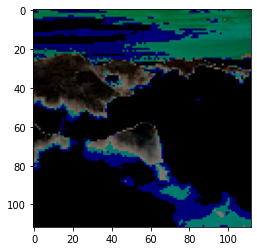

In [55]:
from matplotlib import pyplot as plt

plt.figure()
plt.imshow(x_train[0])
plt.show()

In [56]:
x_train.shape, y_train.shape

((17622, 112, 112, 3), (17622,))

In [57]:
x_val.shape, y_val.shape

NameError: ignored

In [60]:
x_train / 255.0

array([[[[-0.24313725, -0.44705882,  0.36862745],
         [-0.28627451, -0.49019608,  0.3254902 ],
         [-0.31764706,  0.48235294,  0.29411765],
         ...,
         [-0.49411765,  0.33333333,  0.15686275],
         [-0.49019608,  0.3254902 ,  0.15294118],
         [-0.47843137,  0.33333333,  0.16470588]],

        [[-0.27058824, -0.4745098 ,  0.33333333],
         [-0.29019608, -0.48627451,  0.31764706],
         [-0.29411765, -0.49803922,  0.30980392],
         ...,
         [-0.46666667,  0.35686275,  0.18039216],
         [-0.4627451 ,  0.34901961,  0.18039216],
         [-0.47843137,  0.33333333,  0.16470588]],

        [[-0.32156863,  0.47058824,  0.26666667],
         [-0.34901961,  0.44705882,  0.24313725],
         [-0.34901961,  0.44705882,  0.24313725],
         ...,
         [-0.43137255,  0.39215686,  0.21960784],
         [-0.43921569,  0.37647059,  0.20392157],
         [-0.45098039,  0.36470588,  0.19215686]],

        ...,

        [[-0.18823529, -0.22745098, -0

In [58]:
x_train[0][0]

array([[ -62, -114,   94],
       [ -73, -125,   83],
       [ -81,  123,   75],
       [ -85,  120,   71],
       [ -85,  119,   72],
       [ -84,  121,   72],
       [ -85,  120,   70],
       [ -83,  123,   73],
       [ -84,  124,   75],
       [ -78, -126,   81],
       [ -71, -117,   91],
       [ -63, -109,   98],
       [ -57, -102,  106],
       [ -52,  -97,  111],
       [ -55,  -98,  110],
       [ -64, -106,  105],
       [ -68, -111,  105],
       [ -65, -106,  112],
       [ -62, -102,  118],
       [ -58,  -99,  121],
       [ -53,  -92, -126],
       [ -46,  -85, -120],
       [ -48,  -85, -117],
       [ -53,  -90, -122],
       [ -55,  -92, -124],
       [ -58,  -94,  127],
       [ -56,  -97,  125],
       [ -54,  -94,  124],
       [ -54,  -95,  123],
       [ -61, -101,  115],
       [ -67, -111,  104],
       [ -74, -118,   94],
       [ -78, -124,   88],
       [ -80, -125,   86],
       [ -83,  126,   82],
       [ -95,  115,   71],
       [ -83,  123,   77],
 

In [61]:
x_train, x_test = x_train / 255.0, x_test / 255.0
# x_val =  x_val / 255.0

### 2. 모델 구축
- Filtering 층과 Classification 층으로 구분
- Filtering 층 : Dense 대신 Conv2D, MaxPooling2D 사용
    - Conv2D : 
        - filter개수
        - filter_size
        - stride : default = 1
    - MaxPooling2D : 
        - filter_size
        - stride : default = filter_size

- model.summary()
    - 모델 구조, weight 개수 세기 정답지
    - Output Shape : 피처맵 
    - param # : weight 개수

In [62]:
#모델 구축
model = models.Sequential()
## filtering layer
model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(112, 112, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(256, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(512, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(512, (3, 3), activation='relu'))

## classification layer
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

#모델 컴파일
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

Epoch 1/15
441/441 [==============================] - 15s 13ms/step - loss: 1.1606 - accuracy: 0.4834 - val_loss: 9.4867 - val_accuracy: 0.0746
Epoch 2/15
441/441 [==============================] - 5s 11ms/step - loss: 0.9124 - accuracy: 0.6263 - val_loss: 13.9772 - val_accuracy: 0.1084
Epoch 3/15
441/441 [==============================] - 5s 11ms/step - loss: 0.8030 - accuracy: 0.6838 - val_loss: 19.9186 - val_accuracy: 0.1407
Epoch 4/15
441/441 [==============================] - 5s 11ms/step - loss: 0.7076 - accuracy: 0.7315 - val_loss: 17.2075 - val_accuracy: 0.1410
Epoch 5/15
441/441 [==============================] - 5s 11ms/step - loss: 0.6298 - accuracy: 0.7659 - val_loss: 18.1526 - val_accuracy: 0.1132
Epoch 6/15
441/441 [==============================] - 5s 11ms/step - loss: 0.5377 - accuracy: 0.8007 - val_loss: 17.8329 - val_accuracy: 0.1285
Epoch 7/15
441/441 [==============================] - 5s 11ms/step - loss: 0.4538 - accuracy: 0.8319 - val_loss: 20.4760 - val_accuracy:

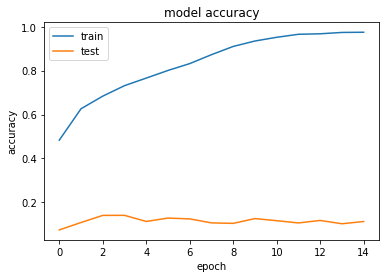

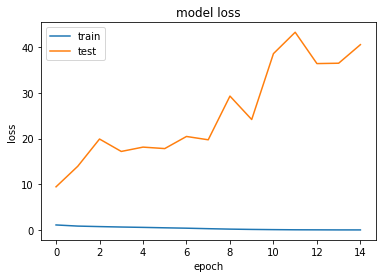

In [64]:
#모델 학습
results = model.fit(x_train, y_train, epochs=15, verbose=1, validation_split=0.2)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [71]:
#모델 검증
test_loss, test_acc = model.evaluate(x_test,  y_test, verbose=1)
print(test_acc)

38/38 [==============================] - 0s 5ms/step - loss: 1.4328 - accuracy: 0.7717
0.7716666460037231


In [67]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 110, 110, 64)      1792      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 55, 55, 64)       0         
 2D)                                                             
                                                                 
 conv2d_9 (Conv2D)           (None, 53, 53, 128)       73856     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 26, 26, 128)      0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 24, 24, 256)       295168    
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 12, 12, 256)     

### ResNet

In [51]:
dir(tf.keras.applications)

['DenseNet121',
 'DenseNet169',
 'DenseNet201',
 'EfficientNetB0',
 'EfficientNetB1',
 'EfficientNetB2',
 'EfficientNetB3',
 'EfficientNetB4',
 'EfficientNetB5',
 'EfficientNetB6',
 'EfficientNetB7',
 'EfficientNetV2B0',
 'EfficientNetV2B1',
 'EfficientNetV2B2',
 'EfficientNetV2B3',
 'EfficientNetV2L',
 'EfficientNetV2M',
 'EfficientNetV2S',
 'InceptionResNetV2',
 'InceptionV3',
 'MobileNet',
 'MobileNetV2',
 'MobileNetV3Large',
 'MobileNetV3Small',
 'NASNetLarge',
 'NASNetMobile',
 'RegNetX002',
 'RegNetX004',
 'RegNetX006',
 'RegNetX008',
 'RegNetX016',
 'RegNetX032',
 'RegNetX040',
 'RegNetX064',
 'RegNetX080',
 'RegNetX120',
 'RegNetX160',
 'RegNetX320',
 'RegNetY002',
 'RegNetY004',
 'RegNetY006',
 'RegNetY008',
 'RegNetY016',
 'RegNetY032',
 'RegNetY040',
 'RegNetY064',
 'RegNetY080',
 'RegNetY120',
 'RegNetY160',
 'RegNetY320',
 'ResNet101',
 'ResNet101V2',
 'ResNet152',
 'ResNet152V2',
 'ResNet50',
 'ResNet50V2',
 'ResNetRS101',
 'ResNetRS152',
 'ResNetRS200',
 'ResNetRS270',
 

In [52]:
from tensorflow.keras.applications.resnet50 import ResNet50

In [53]:
from tensorflow.keras import datasets, layers, models

from tensorflow.keras.layers import Dense, Flatten, MaxPooling2D
from tensorflow.keras import Input
from tensorflow.keras.layers import Dropout, BatchNormalization

import matplotlib.pyplot as plt

In [135]:
x_train.shape, y_train.shape, x_val.shape, y_val.shape

((17595, 112, 112, 3), (17595, 1), (1200, 112, 112, 3), (1200, 1))

In [79]:
y_train = y_train.reshape((17595,1))
y_val = y_val.reshape((1200,1))

In [56]:
label2index = {'buildings' : 0, 'forest' : 1 , 'glacier' : 2 , 'mountain' : 3,
               'sea' : 4, 'street' : 5}

In [136]:
label2index

{'buildings': 0,
 'forest': 1,
 'glacier': 2,
 'mountain': 3,
 'sea': 4,
 'street': 5}

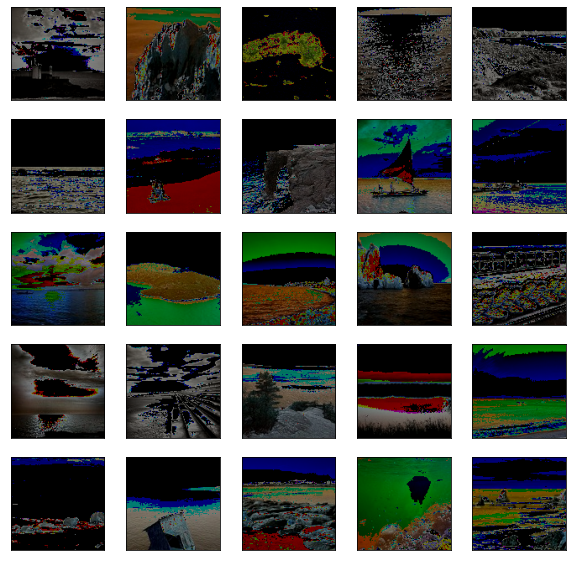

In [82]:
# 이미지 불러보기
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(x_val[i], cmap=plt.cm.binary)
    # plt.xlabel(label2index[y_val[i][0]])
plt.show()

In [83]:
from tensorflow.keras.applications.resnet50 import ResNet50
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')
len(model.layers)

94765736/94765736 [==============================] - 5s 0us/step


In [84]:
model.output_shape

(None, 4, 4, 2048)

In [85]:
model.trainable = False

In [86]:
# sparse categorical crossentropy VS categorical crossentropy + one_hot 
y_train2 = tf.keras.utils.to_categorical(y_train, 6)
y_test2 = tf.keras.utils.to_categorical(y_val, 6)
y_train2.shape, y_test2.shape

((17595, 6), (1200, 6))

In [89]:
y_train2[0]

array([0., 0., 0., 0., 1., 0.], dtype=float32)

In [90]:
model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)

outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

In [ ]:
#모델 학습
results = model.fit(x_train, y_train, epochs=15, verbose=1, validation_data=(x_val, y_val), batch_size=128)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [91]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 256)               8388864   
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 6)                 1542      
                                                                 
Total params: 31,978,118
Trainable params: 8,390,406
Non-trai

In [92]:
# categorical_crossentropy
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'categorical_crossentropy',
                  metrics=['accuracy'])

# 모델 fitting
model.fit(x_train, y_train2, epochs = 5, validation_data=(x_val, y_test2), batch_size=125)

Epoch 1/5
141/141 [==============================] - 16s 34ms/step - loss: 2.4613 - accuracy: 0.5258 - val_loss: 0.5817 - val_accuracy: 0.8133
Epoch 2/5
141/141 [==============================] - 3s 23ms/step - loss: 0.9272 - accuracy: 0.6359 - val_loss: 0.5784 - val_accuracy: 0.8092
Epoch 3/5
141/141 [==============================] - 3s 22ms/step - loss: 0.8376 - accuracy: 0.6658 - val_loss: 0.6047 - val_accuracy: 0.7942
Epoch 4/5
141/141 [==============================] - 3s 23ms/step - loss: 0.7524 - accuracy: 0.6980 - val_loss: 0.5185 - val_accuracy: 0.8308
Epoch 5/5
141/141 [==============================] - 3s 23ms/step - loss: 0.6852 - accuracy: 0.7224 - val_loss: 0.5134 - val_accuracy: 0.8375


In [93]:
# 모델 fitting
model.fit(x_train, y_train2, epochs = 10, validation_data=(x_val, y_test2), batch_size=125)

Epoch 1/10
141/141 [==============================] - 3s 23ms/step - loss: 0.6244 - accuracy: 0.7499 - val_loss: 0.5361 - val_accuracy: 0.8333
Epoch 2/10
141/141 [==============================] - 3s 23ms/step - loss: 0.5878 - accuracy: 0.7603 - val_loss: 0.5057 - val_accuracy: 0.8208
Epoch 3/10
141/141 [==============================] - 3s 23ms/step - loss: 0.5505 - accuracy: 0.7756 - val_loss: 0.4847 - val_accuracy: 0.8375
Epoch 4/10
141/141 [==============================] - 3s 23ms/step - loss: 0.5166 - accuracy: 0.7832 - val_loss: 0.5270 - val_accuracy: 0.8367
Epoch 5/10
141/141 [==============================] - 3s 23ms/step - loss: 0.4835 - accuracy: 0.7966 - val_loss: 0.5219 - val_accuracy: 0.8408
Epoch 6/10
141/141 [==============================] - 3s 22ms/step - loss: 0.4568 - accuracy: 0.8073 - val_loss: 0.5490 - val_accuracy: 0.8408
Epoch 7/10
141/141 [==============================] - 3s 23ms/step - loss: 0.4421 - accuracy: 0.8166 - val_loss: 0.5356 - val_accuracy: 0.8483

In [94]:
# 하위층 일부 재학습
base_model = ResNet50(include_top=False, input_shape = (112,112,3), weights = 'imagenet')

In [95]:
len(base_model.layers)

175

In [96]:
base_model.trainable = False

True

In [97]:
for layer in base_model.layers[:-20]: 
  layer.trainable = False				

for layer in base_model.layers[-100:]:	
  print(layer.name, layer.trainable)

conv3_block4_2_bn False
conv3_block4_2_relu False
conv3_block4_3_conv False
conv3_block4_3_bn False
conv3_block4_add False
conv3_block4_out False
conv4_block1_1_conv False
conv4_block1_1_bn False
conv4_block1_1_relu False
conv4_block1_2_conv False
conv4_block1_2_bn False
conv4_block1_2_relu False
conv4_block1_0_conv False
conv4_block1_3_conv False
conv4_block1_0_bn False
conv4_block1_3_bn False
conv4_block1_add False
conv4_block1_out False
conv4_block2_1_conv False
conv4_block2_1_bn False
conv4_block2_1_relu False
conv4_block2_2_conv False
conv4_block2_2_bn False
conv4_block2_2_relu False
conv4_block2_3_conv False
conv4_block2_3_bn False
conv4_block2_add False
conv4_block2_out False
conv4_block3_1_conv False
conv4_block3_1_bn False
conv4_block3_1_relu False
conv4_block3_2_conv False
conv4_block3_2_bn False
conv4_block3_2_relu False
conv4_block3_3_conv False
conv4_block3_3_bn False
conv4_block3_add False
conv4_block3_out False
conv4_block4_1_conv False
conv4_block4_1_bn False
conv4_bloc

In [100]:
inputs = tf.keras.Input(shape=(112, 112, 3))

x = base_model(inputs, training=False) # batchnorm 부분 update 방지

x = tf.keras.layers.Flatten(input_shape=base_model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

In [101]:
model.compile(optimizer = tf.keras.optimizers.Adam( learning_rate= 0.0001),
                  loss = 'categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 flatten_2 (Flatten)         (None, 32768)             0         
                                                                 
 dense_4 (Dense)             (None, 256)               8388864   
                                                                 
 dropout_2 (Dropout)         (None, 256)               0         
                                                                 
 dense_5 (Dense)             (None, 6)                 1542      
                                                                 
Total params: 31,978,118
Trainable params: 17,321,734
Non-t

In [102]:
model.fit(x_train, y_train2, epochs = 15, validation_data=(x_val, y_test2), 
                   batch_size= 125)

Epoch 1/15
141/141 [==============================] - 9s 34ms/step - loss: 0.9665 - accuracy: 0.6587 - val_loss: 0.4747 - val_accuracy: 0.8358
Epoch 2/15
141/141 [==============================] - 4s 26ms/step - loss: 0.4751 - accuracy: 0.8236 - val_loss: 0.4406 - val_accuracy: 0.8517
Epoch 3/15
141/141 [==============================] - 4s 26ms/step - loss: 0.2751 - accuracy: 0.9004 - val_loss: 0.4208 - val_accuracy: 0.8683
Epoch 4/15
141/141 [==============================] - 4s 26ms/step - loss: 0.1463 - accuracy: 0.9482 - val_loss: 0.4443 - val_accuracy: 0.8667
Epoch 5/15
141/141 [==============================] - 4s 26ms/step - loss: 0.0922 - accuracy: 0.9707 - val_loss: 0.5246 - val_accuracy: 0.8642
Epoch 6/15
141/141 [==============================] - 4s 27ms/step - loss: 0.0584 - accuracy: 0.9825 - val_loss: 0.5384 - val_accuracy: 0.8583
Epoch 7/15
141/141 [==============================] - 4s 26ms/step - loss: 0.0414 - accuracy: 0.9877 - val_loss: 0.5563 - val_accuracy: 0.8717

In [103]:
# 전부 재학습
base_model2 = ResNet50(include_top=False, input_shape = (112,112,3), weights = 'imagenet')

In [104]:
base_model2.trainable = True				

for layer in base_model2.layers[:]:	
  print(layer.name, layer.trainable)

input_6 True
conv1_pad True
conv1_conv True
conv1_bn True
conv1_relu True
pool1_pad True
pool1_pool True
conv2_block1_1_conv True
conv2_block1_1_bn True
conv2_block1_1_relu True
conv2_block1_2_conv True
conv2_block1_2_bn True
conv2_block1_2_relu True
conv2_block1_0_conv True
conv2_block1_3_conv True
conv2_block1_0_bn True
conv2_block1_3_bn True
conv2_block1_add True
conv2_block1_out True
conv2_block2_1_conv True
conv2_block2_1_bn True
conv2_block2_1_relu True
conv2_block2_2_conv True
conv2_block2_2_bn True
conv2_block2_2_relu True
conv2_block2_3_conv True
conv2_block2_3_bn True
conv2_block2_add True
conv2_block2_out True
conv2_block3_1_conv True
conv2_block3_1_bn True
conv2_block3_1_relu True
conv2_block3_2_conv True
conv2_block3_2_bn True
conv2_block3_2_relu True
conv2_block3_3_conv True
conv2_block3_3_bn True
conv2_block3_add True
conv2_block3_out True
conv3_block1_1_conv True
conv3_block1_1_bn True
conv3_block1_1_relu True
conv3_block1_2_conv True
conv3_block1_2_bn True
conv3_block1

In [105]:
inputs = tf.keras.Input(shape=(112, 112, 3))

x = base_model2(inputs, training=False)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

In [106]:
model.compile(optimizer = tf.keras.optimizers.Adam( learning_rate= 0.0001),
                  loss = 'categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 flatten_3 (Flatten)         (None, 32768)             0         
                                                                 
 dense_6 (Dense)             (None, 256)               8388864   
                                                                 
 dropout_3 (Dropout)         (None, 256)               0         
                                                                 
 dense_7 (Dense)             (None, 6)                 1542      
                                                                 
Total params: 31,978,118
Trainable params: 31,924,998
Non-t

In [107]:
model.fit(x_train, y_train2, epochs = 15, validation_data=(x_val, y_test2), 
                   batch_size= 125)

Epoch 1/15
141/141 [==============================] - 16s 78ms/step - loss: 0.9082 - accuracy: 0.6657 - val_loss: 0.4621 - val_accuracy: 0.8342
Epoch 2/15
141/141 [==============================] - 10s 69ms/step - loss: 0.5023 - accuracy: 0.8147 - val_loss: 0.3950 - val_accuracy: 0.8600
Epoch 3/15
141/141 [==============================] - 10s 69ms/step - loss: 0.3348 - accuracy: 0.8796 - val_loss: 0.4209 - val_accuracy: 0.8750
Epoch 4/15
141/141 [==============================] - 10s 69ms/step - loss: 0.2257 - accuracy: 0.9178 - val_loss: 0.4328 - val_accuracy: 0.8692
Epoch 5/15
141/141 [==============================] - 10s 69ms/step - loss: 0.1404 - accuracy: 0.9495 - val_loss: 0.5194 - val_accuracy: 0.8675
Epoch 6/15
141/141 [==============================] - 10s 69ms/step - loss: 0.0960 - accuracy: 0.9682 - val_loss: 0.5645 - val_accuracy: 0.8567
Epoch 7/15
141/141 [==============================] - 10s 69ms/step - loss: 0.0602 - accuracy: 0.9803 - val_loss: 0.5417 - val_accuracy:

In [110]:
# fine tune
## 일부 재학습 모델
base_model = ResNet50(include_top=False, input_shape = (112,112,3), weights = 'imagenet')

# base_model.trainable = False

# for layer in base_model.layers[-10:]: 
#     layer.trainable = True				

base_model.trainable = True

for layer in base_model.layers[:-10]: 
    layer.trainable = False				


inputs = tf.keras.Input(shape=(112, 112, 3))

x = base_model(inputs, training=False) # batchnorm 부분 update 방지

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam( learning_rate= 0.0001),
                loss = 'categorical_crossentropy',
                metrics=['accuracy'])

In [111]:
model.fit(x_train, y_train2, epochs = 5, validation_data=(x_val, y_test2), 
                   batch_size= 125)

Epoch 1/5
141/141 [==============================] - 7s 31ms/step - loss: 1.0482 - accuracy: 0.6417 - val_loss: 0.5052 - val_accuracy: 0.8175
Epoch 2/5
141/141 [==============================] - 3s 24ms/step - loss: 0.5243 - accuracy: 0.8044 - val_loss: 0.4474 - val_accuracy: 0.8542
Epoch 3/5
141/141 [==============================] - 3s 24ms/step - loss: 0.3198 - accuracy: 0.8822 - val_loss: 0.4601 - val_accuracy: 0.8592
Epoch 4/5
141/141 [==============================] - 3s 25ms/step - loss: 0.2043 - accuracy: 0.9282 - val_loss: 0.4792 - val_accuracy: 0.8458
Epoch 5/5
141/141 [==============================] - 3s 25ms/step - loss: 0.1324 - accuracy: 0.9566 - val_loss: 0.5483 - val_accuracy: 0.8333


In [112]:
## fine-tune
base_model.trainable = True

model.compile(optimizer = tf.keras.optimizers.Adam( learning_rate= 0.0001),
                loss = 'categorical_crossentropy',
                metrics=['accuracy'])

model.fit(x_train, y_train2, epochs = 10, validation_data=(x_val, y_test2), 
                   batch_size= 125)

Epoch 1/10
141/141 [==============================] - 16s 77ms/step - loss: 0.5513 - accuracy: 0.8025 - val_loss: 0.4191 - val_accuracy: 0.8517
Epoch 2/10
141/141 [==============================] - 10s 69ms/step - loss: 0.2771 - accuracy: 0.8999 - val_loss: 0.4324 - val_accuracy: 0.8550
Epoch 3/10
141/141 [==============================] - 10s 69ms/step - loss: 0.1545 - accuracy: 0.9458 - val_loss: 0.5009 - val_accuracy: 0.8617
Epoch 4/10
141/141 [==============================] - 10s 69ms/step - loss: 0.1173 - accuracy: 0.9582 - val_loss: 0.5565 - val_accuracy: 0.8592
Epoch 5/10
141/141 [==============================] - 10s 69ms/step - loss: 0.0932 - accuracy: 0.9694 - val_loss: 0.5135 - val_accuracy: 0.8708
Epoch 6/10
141/141 [==============================] - 10s 70ms/step - loss: 0.0773 - accuracy: 0.9731 - val_loss: 0.6382 - val_accuracy: 0.8692
Epoch 7/10
141/141 [==============================] - 10s 70ms/step - loss: 0.0648 - accuracy: 0.9777 - val_loss: 0.6145 - val_accuracy:

### ResNet152

In [114]:
from tensorflow.keras.applications.resnet import ResNet152

In [115]:
from tensorflow.keras import datasets, layers, models

from tensorflow.keras.layers import Dense, Flatten, MaxPooling2D
from tensorflow.keras import Input
from tensorflow.keras.layers import Dropout, BatchNormalization

import matplotlib.pyplot as plt

In [125]:
base_model = ResNet152(include_top=False, input_shape = (112,112,3), weights = 'imagenet')
len(base_model.layers)

234698864/234698864 [==============================] - 11s 0us/step


515

In [126]:
## 일부 재학습 모델
# base_model = ResNet152(include_top=False, input_shape = (112,112,3), weights = 'imagenet')

# base_model.trainable = False

# for layer in base_model.layers[-10:]: 
#     layer.trainable = True				

base_model.trainable = True

# for layer in base_model.layers[:-10]: 
#     layer.trainable = False				


inputs = tf.keras.Input(shape=(112, 112, 3))

x = base_model(inputs, training=False) # batchnorm 부분 update 방지

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam( learning_rate= 0.0001),
                loss = 'categorical_crossentropy',
                metrics=['accuracy'])

In [127]:
model.fit(x_train, y_train2, epochs = 15, validation_data=(x_val, y_test2), 
                   batch_size= 125)

Epoch 1/15
141/141 [==============================] - 40s 172ms/step - loss: 1.1190 - accuracy: 0.5671 - val_loss: 0.5223 - val_accuracy: 0.8075
Epoch 2/15
141/141 [==============================] - 21s 152ms/step - loss: 0.6310 - accuracy: 0.7681 - val_loss: 0.4258 - val_accuracy: 0.8533
Epoch 3/15
141/141 [==============================] - 21s 152ms/step - loss: 0.4635 - accuracy: 0.8320 - val_loss: 0.3567 - val_accuracy: 0.8817
Epoch 4/15
141/141 [==============================] - 21s 152ms/step - loss: 0.3108 - accuracy: 0.8868 - val_loss: 0.4273 - val_accuracy: 0.8675
Epoch 5/15
141/141 [==============================] - 21s 152ms/step - loss: 0.2536 - accuracy: 0.9074 - val_loss: 0.4030 - val_accuracy: 0.8775
Epoch 6/15
141/141 [==============================] - 22s 153ms/step - loss: 0.1450 - accuracy: 0.9478 - val_loss: 0.4877 - val_accuracy: 0.8808
Epoch 7/15
141/141 [==============================] - 22s 153ms/step - loss: 0.1222 - accuracy: 0.9576 - val_loss: 0.6020 - val_ac

In [128]:
from tensorflow.keras.applications import VGG16
base_model = VGG16(include_top=False, input_shape = (112,112,3), weights = 'imagenet')
len(base_model.layers)

58889256/58889256 [==============================] - 3s 0us/step


19

In [129]:
## 일부 재학습 모델
# base_model = ResNet152(include_top=False, input_shape = (112,112,3), weights = 'imagenet')

# base_model.trainable = False

# for layer in base_model.layers[-10:]: 
#     layer.trainable = True				

base_model.trainable = True

# for layer in base_model.layers[:-10]: 
#     layer.trainable = False				


inputs = tf.keras.Input(shape=(112, 112, 3))

x = base_model(inputs, training=False) # batchnorm 부분 update 방지

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam( learning_rate= 0.0001),
                loss = 'categorical_crossentropy',
                metrics=['accuracy'])

In [134]:
results = model.fit(x_train, y_train2, epochs = 15, validation_data=(x_val, y_test2), 
                   batch_size= 125)

Epoch 1/15
141/141 [==============================] - 9s 63ms/step - loss: 0.0581 - accuracy: 0.9803 - val_loss: 0.7774 - val_accuracy: 0.8333
Epoch 2/15
141/141 [==============================] - 9s 63ms/step - loss: 0.0607 - accuracy: 0.9809 - val_loss: 0.7950 - val_accuracy: 0.8458
Epoch 3/15
 58/141 [===========>..................] - ETA: 5s - loss: 0.0748 - accuracy: 0.9750

KeyboardInterrupt: ignored

In [133]:
plt.figure(figsize=(12, 10))
plt.plot(np.arange(1, 16), results.history['val_loss'], label='CNN')
plt.plot(np.arange(1, 16), transfer_history.history['val_loss'], label='TRANSFER')
plt.xlabel('EPOCHS')
plt.ylabel('LOSSES')
plt.title('LOSSES')
plt.legend()
plt.show()

NameError: ignored

<Figure size 864x720 with 0 Axes>

In [132]:
from IPython.display import Image
import numpy as np
import matplotlib.pyplot as plt

### 정신차리고 그래프


In [137]:
from tensorflow.keras.applications.resnet50 import ResNet50
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')
len(model.layers)

175

In [138]:
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')

model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)

outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

Epoch 1/15
138/138 [==============================] - 7s 31ms/step - loss: 2.3990 - accuracy: 0.5455 - val_loss: 0.5895 - val_accuracy: 0.8042
Epoch 2/15
138/138 [==============================] - 3s 22ms/step - loss: 0.8825 - accuracy: 0.6532 - val_loss: 0.5599 - val_accuracy: 0.8117
Epoch 3/15
138/138 [==============================] - 3s 21ms/step - loss: 0.7858 - accuracy: 0.6956 - val_loss: 0.5352 - val_accuracy: 0.8125
Epoch 4/15
138/138 [==============================] - 3s 22ms/step - loss: 0.7194 - accuracy: 0.7152 - val_loss: 0.5178 - val_accuracy: 0.8233
Epoch 5/15
138/138 [==============================] - 3s 22ms/step - loss: 0.6477 - accuracy: 0.7381 - val_loss: 0.4825 - val_accuracy: 0.8408
Epoch 6/15
138/138 [==============================] - 3s 22ms/step - loss: 0.6043 - accuracy: 0.7604 - val_loss: 0.4988 - val_accuracy: 0.8267
Epoch 7/15
138/138 [==============================] - 3s 22ms/step - loss: 0.5598 - accuracy: 0.7726 - val_loss: 0.4907 - val_accuracy: 0.8358

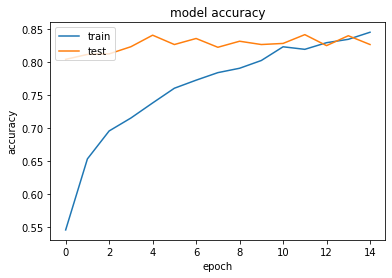

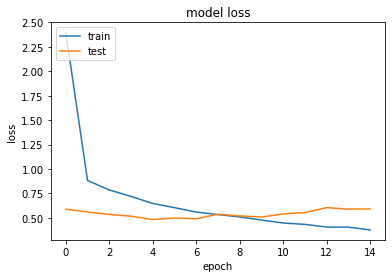

In [139]:
#모델 학습
results = model.fit(x_train, y_train, epochs=15, verbose=1, validation_data=(x_val, y_val), batch_size=128)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [144]:
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')

model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(64, activation='relu')(x)

outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Epoch 1/30
138/138 [==============================] - 7s 29ms/step - loss: 2.0754 - accuracy: 0.5095 - val_loss: 0.6717 - val_accuracy: 0.7433
Epoch 2/30
138/138 [==============================] - 3s 22ms/step - loss: 0.9760 - accuracy: 0.6199 - val_loss: 0.6294 - val_accuracy: 0.7592
Epoch 3/30
138/138 [==============================] - 3s 22ms/step - loss: 0.8703 - accuracy: 0.6709 - val_loss: 0.5974 - val_accuracy: 0.7942
Epoch 4/30
138/138 [==============================] - 3s 22ms/step - loss: 0.8000 - accuracy: 0.6936 - val_loss: 0.5578 - val_accuracy: 0.7967
Epoch 5/30
138/138 [==============================] - 3s 22ms/step - loss: 0.7116 - accuracy: 0.7300 - val_loss: 0.5709 - val_accuracy: 0.8125
Epoch 6/30
138/138 [==============================] - 3s 22ms/step - loss: 0.6670 - accuracy: 0.7446 - val_loss: 0.5130 - val_accuracy: 0.8142
Epoch 7/30
138/138 [==============================] - 3s 22ms/step - loss: 0.6281 - accuracy: 0.7591 - val_loss: 0.5030 - val_accuracy: 0.8258

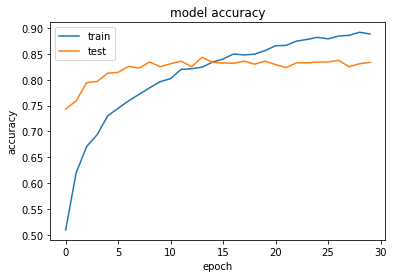

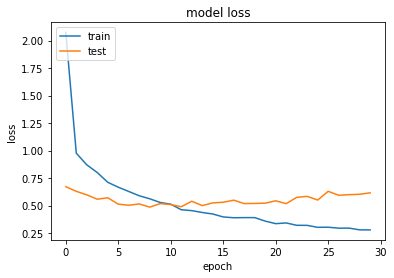

In [146]:
#모델 학습
results = model.fit(x_train, y_train, epochs=30, verbose=1, validation_data=(x_val, y_val), batch_size=128)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [147]:
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')

model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dense(64, activation='relu')(x)

outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Model: "model_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_23 (InputLayer)       [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 flatten_11 (Flatten)        (None, 32768)             0         
                                                                 
 dense_24 (Dense)            (None, 256)               8388864   
                                                                 
 dropout_12 (Dropout)        (None, 256)               0         
                                                                 
 dense_25 (Dense)            (None, 128)               32896     
                                                                 
 dense_26 (Dense)            (None, 64)                825

Epoch 1/30
138/138 [==============================] - 7s 29ms/step - loss: 1.7292 - accuracy: 0.5267 - val_loss: 0.6353 - val_accuracy: 0.7758
Epoch 2/30
138/138 [==============================] - 3s 22ms/step - loss: 0.9202 - accuracy: 0.6434 - val_loss: 0.5571 - val_accuracy: 0.8025
Epoch 3/30
138/138 [==============================] - 3s 22ms/step - loss: 0.8192 - accuracy: 0.6858 - val_loss: 0.5467 - val_accuracy: 0.8075
Epoch 4/30
138/138 [==============================] - 3s 22ms/step - loss: 0.7622 - accuracy: 0.7070 - val_loss: 0.5583 - val_accuracy: 0.7983
Epoch 5/30
138/138 [==============================] - 3s 22ms/step - loss: 0.7070 - accuracy: 0.7293 - val_loss: 0.5364 - val_accuracy: 0.8033
Epoch 6/30
138/138 [==============================] - 3s 22ms/step - loss: 0.6457 - accuracy: 0.7515 - val_loss: 0.5024 - val_accuracy: 0.8383
Epoch 7/30
138/138 [==============================] - 3s 22ms/step - loss: 0.5835 - accuracy: 0.7767 - val_loss: 0.4956 - val_accuracy: 0.8183

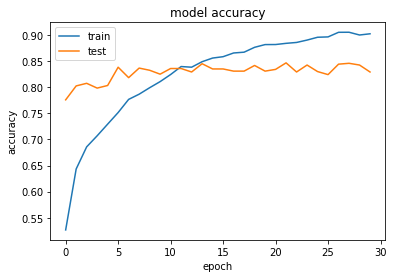

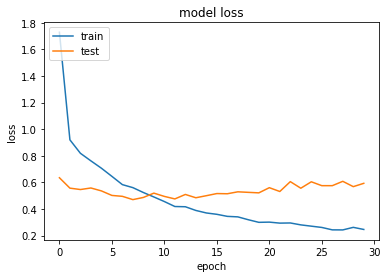

In [148]:
#모델 학습
results = model.fit(x_train, y_train, epochs=30, verbose=1, validation_data=(x_val, y_val), batch_size=128)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [150]:
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')

model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D((2, 2))(x)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)

outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Model: "model_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 conv2d_1 (Conv2D)           (None, 2, 2, 128)         2359424   
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 1, 1, 128)        0         
 2D)                                                             
                                                                 
 flatten_13 (Flatten)        (None, 128)               0         
                                                                 
 dense_32 (Dense)            (None, 256)               33024     
                                                          

Epoch 1/30
138/138 [==============================] - 7s 30ms/step - loss: 1.3101 - accuracy: 0.6083 - val_loss: 0.5730 - val_accuracy: 0.8067
Epoch 2/30
138/138 [==============================] - 3s 23ms/step - loss: 0.6792 - accuracy: 0.7687 - val_loss: 0.5413 - val_accuracy: 0.8192
Epoch 3/30
138/138 [==============================] - 3s 23ms/step - loss: 0.5140 - accuracy: 0.8224 - val_loss: 0.5531 - val_accuracy: 0.8117
Epoch 4/30
138/138 [==============================] - 3s 22ms/step - loss: 0.3973 - accuracy: 0.8619 - val_loss: 0.5570 - val_accuracy: 0.8317
Epoch 5/30
138/138 [==============================] - 3s 23ms/step - loss: 0.3163 - accuracy: 0.8896 - val_loss: 0.5710 - val_accuracy: 0.8250
Epoch 6/30
138/138 [==============================] - 3s 23ms/step - loss: 0.2436 - accuracy: 0.9145 - val_loss: 0.6246 - val_accuracy: 0.8400
Epoch 7/30
138/138 [==============================] - 3s 23ms/step - loss: 0.2124 - accuracy: 0.9266 - val_loss: 0.6807 - val_accuracy: 0.8125

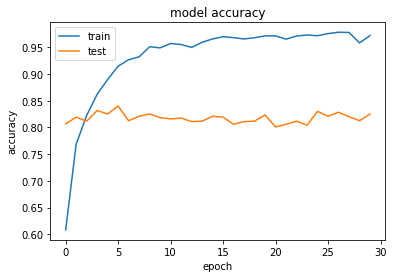

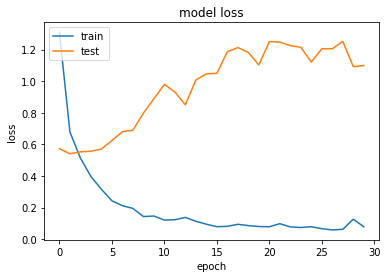

In [151]:
#모델 학습
results = model.fit(x_train, y_train, epochs=30, verbose=1, validation_data=(x_val, y_val), batch_size=128)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [152]:
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')

model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu')(x)
# x = tf.keras.layers.MaxPooling2D((2, 2))(x)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)

outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Model: "model_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 conv2d_2 (Conv2D)           (None, 2, 2, 128)         2359424   
                                                                 
 flatten_14 (Flatten)        (None, 512)               0         
                                                                 
 dense_34 (Dense)            (None, 256)               131328    
                                                                 
 dropout_15 (Dropout)        (None, 256)               0         
                                                                 
 dense_35 (Dense)            (None, 6)                 154

Epoch 1/30
138/138 [==============================] - 7s 30ms/step - loss: 1.3740 - accuracy: 0.5823 - val_loss: 0.6253 - val_accuracy: 0.7767
Epoch 2/30
138/138 [==============================] - 3s 23ms/step - loss: 0.7025 - accuracy: 0.7420 - val_loss: 0.6765 - val_accuracy: 0.7550
Epoch 3/30
138/138 [==============================] - 3s 22ms/step - loss: 0.5336 - accuracy: 0.8070 - val_loss: 0.5236 - val_accuracy: 0.8200
Epoch 4/30
138/138 [==============================] - 3s 22ms/step - loss: 0.4182 - accuracy: 0.8464 - val_loss: 0.6097 - val_accuracy: 0.8058
Epoch 5/30
138/138 [==============================] - 3s 22ms/step - loss: 0.3331 - accuracy: 0.8761 - val_loss: 0.5743 - val_accuracy: 0.8250
Epoch 6/30
138/138 [==============================] - 3s 23ms/step - loss: 0.2562 - accuracy: 0.9073 - val_loss: 0.7877 - val_accuracy: 0.7842
Epoch 7/30
138/138 [==============================] - 3s 23ms/step - loss: 0.2144 - accuracy: 0.9244 - val_loss: 0.6874 - val_accuracy: 0.8217

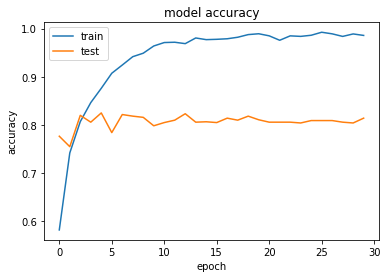

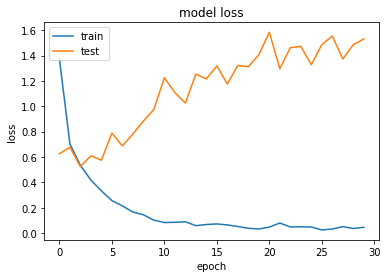

In [153]:
#모델 학습
results = model.fit(x_train, y_train, epochs=30, verbose=1, validation_data=(x_val, y_val), batch_size=128)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [163]:
model = ResNet50(include_top=False, input_shape = (112, 112 ,3), weights = 'imagenet')

model.trainable = False
# model.Sequential()없이 모델 구축
inputs = tf.keras.Input(shape=(112, 112, 3))

x = model(inputs, training=False)

# x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu')(x)
# x = tf.keras.layers.MaxPooling2D((2, 2))(x)

x = tf.keras.layers.Flatten(input_shape=model.output_shape[1:])(x)
# x = tf.keras.layers.Dense(512, activation='relu')(x)
# x= tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x= tf.keras.layers.Dropout(0.5)(x)

# x = tf.keras.layers.Dense(128, activation='relu')(x)
# x= tf.keras.layers.Dropout(0.5)(x)
# x = tf.keras.layers.Dense(64, activation='relu')(x)
# x= tf.keras.layers.Dropout(0.5)(x)
outputs = tf.keras.layers.Dense(6, activation='softmax')(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate= 0.001),
                  loss = 'sparse_categorical_crossentropy',
                  metrics=['accuracy'])

model.summary()

Model: "model_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_41 (InputLayer)       [(None, 112, 112, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 flatten_20 (Flatten)        (None, 32768)             0         
                                                                 
 dense_50 (Dense)            (None, 256)               8388864   
                                                                 
 dropout_24 (Dropout)        (None, 256)               0         
                                                                 
 dense_51 (Dense)            (None, 6)                 1542      
                                                                 
Total params: 31,978,118
Trainable params: 8,390,406
Non-t

Epoch 1/30
275/275 [==============================] - 9s 18ms/step - loss: 1.6992 - accuracy: 0.5558 - val_loss: 0.6110 - val_accuracy: 0.7775
Epoch 2/30
275/275 [==============================] - 4s 15ms/step - loss: 0.9374 - accuracy: 0.6311 - val_loss: 0.5855 - val_accuracy: 0.8092
Epoch 3/30
275/275 [==============================] - 4s 15ms/step - loss: 0.8493 - accuracy: 0.6691 - val_loss: 0.5481 - val_accuracy: 0.8058
Epoch 4/30
275/275 [==============================] - 4s 15ms/step - loss: 0.7692 - accuracy: 0.7020 - val_loss: 0.5381 - val_accuracy: 0.8108
Epoch 5/30
275/275 [==============================] - 4s 15ms/step - loss: 0.7094 - accuracy: 0.7238 - val_loss: 0.5005 - val_accuracy: 0.8250
Epoch 6/30
275/275 [==============================] - 4s 15ms/step - loss: 0.6541 - accuracy: 0.7357 - val_loss: 0.5152 - val_accuracy: 0.8225
Epoch 7/30
275/275 [==============================] - 4s 15ms/step - loss: 0.6272 - accuracy: 0.7535 - val_loss: 0.5150 - val_accuracy: 0.8308

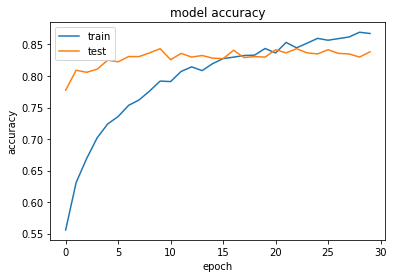

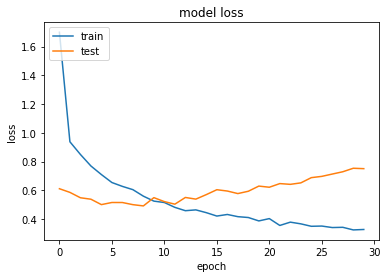

In [164]:
#모델 학습
results = model.fit(x_train, y_train, epochs=30, verbose=1, validation_data=(x_val, y_val), batch_size=64)
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# Food

In [ ]:
pip install split-folders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# 캐글 설치
!pip install -q kaggle

In [ ]:
cd /content 

/content


In [ ]:
# kaggle.json 넣어주어야함

In [ ]:
# .kaggle 폴더 생성
!mkdir -p ~/.kaggle/
# kaggle.josn .kaggle로 복사
!cp kaggle.json ~/.kaggle/
# 해당 폴더 목록 확인(복사 잘 되었는지 확인)
!ls ~/.kaggle

kaggle.json


In [ ]:
cd ~

/root


In [ ]:
!ls -a

.   .bashrc  .config   .jupyter  .keras  .npm	   .tmux.conf
..  .cache   .ipython  .kaggle	 .local  .profile  .wget-hsts


In [ ]:
!ls .kaggle -al

total 16
drwxr-xr-x 2 root root 4096 Nov 24 23:57 .
drwx------ 1 root root 4096 Nov 24 23:57 ..
-rw-r--r-- 1 root root   66 Nov 24 23:57 kaggle.json


In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!ls .kaggle -al

total 16
drwxr-xr-x 2 root root 4096 Nov 24 23:57 .
drwx------ 1 root root 4096 Nov 24 23:57 ..
-rw------- 1 root root   66 Nov 24 23:57 kaggle.json


In [ ]:
cd /content

/content


In [ ]:
!kaggle datasets download -d kmader/food41

100% 5.29G/5.30G [00:29<00:00, 163MB/s]
100% 5.30G/5.30G [00:29<00:00, 192MB/s]


In [ ]:
!unzip -q food41.zip

In [ ]:
import splitfolders

import os

import cv2
import numpy as np
from tqdm.notebook import tqdm

from matplotlib import pyplot as plt
import matplotlib.cm as cm

import tensorflow as tf

import pickle

from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

In [ ]:
from tensorflow.keras import datasets, layers, models

from tensorflow.keras.layers import Dense, Flatten, MaxPooling2D
from tensorflow.keras import Input
from tensorflow.keras.layers import Dropout, BatchNormalization

import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

In [ ]:
folder_path = '/content/images'
label_names = os.listdir(folder_path)
label_names

['steak',
 'lasagna',
 'pad_thai',
 'baklava',
 'huevos_rancheros',
 'carrot_cake',
 'spaghetti_carbonara',
 'french_toast',
 'fish_and_chips',
 'nachos',
 'onion_rings',
 'shrimp_and_grits',
 'waffles',
 'gyoza',
 'chicken_wings',
 'beef_tartare',
 'chocolate_mousse',
 'foie_gras',
 'samosa',
 'lobster_bisque',
 'beet_salad',
 'red_velvet_cake',
 'bruschetta',
 'caesar_salad',
 'hot_and_sour_soup',
 'escargots',
 'mussels',
 'strawberry_shortcake',
 'crab_cakes',
 'pulled_pork_sandwich',
 'deviled_eggs',
 'dumplings',
 'poutine',
 'ice_cream',
 'french_onion_soup',
 'spring_rolls',
 'grilled_cheese_sandwich',
 'pho',
 'cup_cakes',
 'seaweed_salad',
 'filet_mignon',
 'ceviche',
 'peking_duck',
 'grilled_salmon',
 'tacos',
 'cheesecake',
 'paella',
 'macarons',
 'chicken_quesadilla',
 'pizza',
 'tuna_tartare',
 'clam_chowder',
 'bread_pudding',
 'french_fries',
 'guacamole',
 'macaroni_and_cheese',
 'apple_pie',
 'bibimbap',
 'donuts',
 'sashimi',
 'caprese_salad',
 'sushi',
 'hamburger

In [ ]:
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'steak': ['/content/images/steak/734445.jpg',
  '/content/images/steak/1382427.jpg',
  '/content/images/steak/214320.jpg',
  '/content/images/steak/2260231.jpg',
  '/content/images/steak/3388717.jpg',
  '/content/images/steak/2644457.jpg',
  '/content/images/steak/440188.jpg',
  '/content/images/steak/3334973.jpg',
  '/content/images/steak/285269.jpg',
  '/content/images/steak/2315011.jpg',
  '/content/images/steak/3389138.jpg',
  '/content/images/steak/1872368.jpg',
  '/content/images/steak/3752362.jpg',
  '/content/images/steak/2425062.jpg',
  '/content/images/steak/9555.jpg',
  '/content/images/steak/3047807.jpg',
  '/content/images/steak/3503350.jpg',
  '/content/images/steak/1476404.jpg',
  '/content/images/steak/2133717.jpg',
  '/content/images/steak/3770370.jpg',
  '/content/images/steak/1212161.jpg',
  '/content/images/steak/144370.jpg',
  '/content/images/steak/168775.jpg',
  '/content/images/steak/3829392.jpg',
  '/content/images/steak/1615395.jpg',
  '/content/images/steak/

In [ ]:
!mkdir resized

In [ ]:
cd /content/resized

/content/resized


In [ ]:
# 라벨이름 폴더 생성 
for label in label_names:
    os.mkdir(label) 

In [ ]:
for label, filenames in tqdm(dataset.items()):
    for filename in filenames:
        img = cv2.imread(filename)

        # 이미지의 x, y가 224이 넘을 경우 작게해주기
        percent = 1
        if(img.shape[1] > img.shape[0]) :       # 이미지의 가로가 세보다 크면 가로를 640으로 맞추고 세로를 비율에 맞춰서
            percent = 112/img.shape[1]
        else :
            percent = 112/img.shape[0]

        img = cv2.resize(img, dsize=(0, 0), fx=percent, fy=percent, interpolation=cv2.INTER_LINEAR)
                # 이미지 범위 지정
        y,x,h,w = (0,0,img.shape[0], img.shape[1])

        # 그림 주변에 검은색으로 칠하기
        w_x = (112-(w-x))/2  # w_x = (224 - 그림)을 뺀 나머지 영역 크기 [ 그림나머지/2 [그림] 그림나머지/2 ]
        h_y = (112-(h-y))/2

        if(w_x < 0):         # 크기가 -면 0으로 지정.
            w_x = 0
        elif(h_y < 0):
            h_y = 0

        M = np.float32([[1,0,w_x], [0,1,h_y]])  #(2*3 이차원 행렬)
        img_re = cv2.warpAffine(img, M, (112, 112)) #이동변환  
       
        # cv2.imwrite('{0}.jpg',image .format(file)) #파일저장
        cv2.imwrite('/content/resized/{0}/{1}'.format(label, filename.split("/")[-1]) , img_re)

  0%|          | 0/101 [00:00<?, ?it/s]

In [ ]:
splitfolders.ratio('/content/resized', output='/content/dataset', seed=77, ratio=(0.6, 0.2, 0.2))

Copying files: 101000 files [00:44, 2272.77 files/s]


In [ ]:
folder_path = '/content/dataset/train'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'steak': ['/content/dataset/train/steak/1382427.jpg',
  '/content/dataset/train/steak/214320.jpg',
  '/content/dataset/train/steak/2260231.jpg',
  '/content/dataset/train/steak/3388717.jpg',
  '/content/dataset/train/steak/285269.jpg',
  '/content/dataset/train/steak/2315011.jpg',
  '/content/dataset/train/steak/3389138.jpg',
  '/content/dataset/train/steak/1872368.jpg',
  '/content/dataset/train/steak/2425062.jpg',
  '/content/dataset/train/steak/3047807.jpg',
  '/content/dataset/train/steak/1476404.jpg',
  '/content/dataset/train/steak/2133717.jpg',
  '/content/dataset/train/steak/3770370.jpg',
  '/content/dataset/train/steak/144370.jpg',
  '/content/dataset/train/steak/168775.jpg',
  '/content/dataset/train/steak/3829392.jpg',
  '/content/dataset/train/steak/1615395.jpg',
  '/content/dataset/train/steak/3622237.jpg',
  '/content/dataset/train/steak/2138335.jpg',
  '/content/dataset/train/steak/2499364.jpg',
  '/content/dataset/train/steak/3142618.jpg',
  '/content/dataset/train/ste

In [ ]:
label2index = {}
for idx, label in enumerate(label_names):
    label2index[label] = idx
label2index

{'steak': 0,
 'lasagna': 1,
 'pad_thai': 2,
 'baklava': 3,
 'huevos_rancheros': 4,
 'carrot_cake': 5,
 'spaghetti_carbonara': 6,
 'french_toast': 7,
 'fish_and_chips': 8,
 'nachos': 9,
 'onion_rings': 10,
 'shrimp_and_grits': 11,
 'waffles': 12,
 'gyoza': 13,
 'chicken_wings': 14,
 'beef_tartare': 15,
 'chocolate_mousse': 16,
 'foie_gras': 17,
 'samosa': 18,
 'lobster_bisque': 19,
 'beet_salad': 20,
 'red_velvet_cake': 21,
 'bruschetta': 22,
 'caesar_salad': 23,
 'hot_and_sour_soup': 24,
 'escargots': 25,
 'mussels': 26,
 'strawberry_shortcake': 27,
 'crab_cakes': 28,
 'pulled_pork_sandwich': 29,
 'deviled_eggs': 30,
 'dumplings': 31,
 'poutine': 32,
 'ice_cream': 33,
 'french_onion_soup': 34,
 'spring_rolls': 35,
 'grilled_cheese_sandwich': 36,
 'pho': 37,
 'cup_cakes': 38,
 'seaweed_salad': 39,
 'filet_mignon': 40,
 'ceviche': 41,
 'peking_duck': 42,
 'grilled_salmon': 43,
 'tacos': 44,
 'cheesecake': 45,
 'paella': 46,
 'macarons': 47,
 'chicken_quesadilla': 48,
 'pizza': 49,
 'tuna

In [ ]:
x_train, y_train = [], []

for label, filenames in dataset.items():
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_train.append(image)
        y_train.append(label2index[label]) # label을 index로 변경

In [ ]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [ ]:
x_train = x_train.astype('float32')

In [ ]:
x_train.shape, y_train.shape

((60600, 112, 112, 3), (60600,))

In [ ]:
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
)

In [ ]:
folder_path

'/content/dataset/train'

In [ ]:
for label in  tqdm(os.listdir(folder_path)):
    label_path = folder_path + '/' + label + '/'
    for filename in os.listdir(label_path): 
        filepath = label_path + filename

        img = load_img(filepath)
        # img 출력
        # plt.imshow(img)
        # break
        x = img_to_array(img)
        # x.shape 출력
        # print(x.shape)
        # break
        x = x.reshape((1,) + x.shape)

        i = 0
        # flow : augmentation 함수
        for batch in datagen.flow(x, batch_size=1,
                                save_to_dir=label_path, save_prefix=label, save_format='jpg'):
            i += 1
            if i > 1:
                break  

In [ ]:
folder_path = '/content/dataset/train'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'steak': ['/content/dataset/train/steak/1382427.jpg',
  '/content/dataset/train/steak/steak_0_8342.jpg',
  '/content/dataset/train/steak/steak_0_4653.jpg',
  '/content/dataset/train/steak/214320.jpg',
  '/content/dataset/train/steak/2260231.jpg',
  '/content/dataset/train/steak/steak_0_3793.jpg',
  '/content/dataset/train/steak/steak_0_7822.jpg',
  '/content/dataset/train/steak/3388717.jpg',
  '/content/dataset/train/steak/steak_0_8109.jpg',
  '/content/dataset/train/steak/285269.jpg',
  '/content/dataset/train/steak/2315011.jpg',
  '/content/dataset/train/steak/3389138.jpg',
  '/content/dataset/train/steak/steak_0_2877.jpg',
  '/content/dataset/train/steak/1872368.jpg',
  '/content/dataset/train/steak/2425062.jpg',
  '/content/dataset/train/steak/3047807.jpg',
  '/content/dataset/train/steak/steak_0_6617.jpg',
  '/content/dataset/train/steak/steak_0_2425.jpg',
  '/content/dataset/train/steak/steak_0_6166.jpg',
  '/content/dataset/train/steak/1476404.jpg',
  '/content/dataset/train/st

In [ ]:
len(dataset)

101

In [ ]:
x_train, y_train = [], []

for label, filenames in tqdm(dataset.items()):
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_train.append(image)
        y_train.append(label2index[label]) # label을 index로 변경

  0%|          | 0/101 [00:00<?, ?it/s]

In [ ]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [ ]:
x_train.dtype

dtype('float32')

In [ ]:
x_train = x_train.astype('float32')

In [ ]:
x_train.shape, y_train.shape

((174731, 112, 112, 3), (174731,))

In [ ]:
folder_path = '/content/dataset/val'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'steak': ['/content/dataset/val/steak/734445.jpg',
  '/content/dataset/val/steak/2644457.jpg',
  '/content/dataset/val/steak/440188.jpg',
  '/content/dataset/val/steak/1403005.jpg',
  '/content/dataset/val/steak/2353677.jpg',
  '/content/dataset/val/steak/2254705.jpg',
  '/content/dataset/val/steak/3470083.jpg',
  '/content/dataset/val/steak/835871.jpg',
  '/content/dataset/val/steak/2825100.jpg',
  '/content/dataset/val/steak/332232.jpg',
  '/content/dataset/val/steak/2622140.jpg',
  '/content/dataset/val/steak/1512226.jpg',
  '/content/dataset/val/steak/1675632.jpg',
  '/content/dataset/val/steak/3522209.jpg',
  '/content/dataset/val/steak/3393688.jpg',
  '/content/dataset/val/steak/1678108.jpg',
  '/content/dataset/val/steak/56409.jpg',
  '/content/dataset/val/steak/2193535.jpg',
  '/content/dataset/val/steak/3059843.jpg',
  '/content/dataset/val/steak/1995252.jpg',
  '/content/dataset/val/steak/2668916.jpg',
  '/content/dataset/val/steak/2614189.jpg',
  '/content/dataset/val/steak

In [ ]:
x_val, y_val = [], []

for label, filenames in dataset.items():
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_val.append(image)
        y_val.append(label2index[label]) # label을 index로 변경

In [ ]:
x_val, y_val= np.array(x_val), np.array(y_val)

In [ ]:
x_val = x_val.astype('float32')

In [ ]:
x_val.shape, y_val.shape

((20200, 112, 112, 3), (20200,))

In [ ]:
folder_path = '/content/dataset/test'
dataset = {}

# 이미지와 라벨 리스트에 담기
for label in os.listdir(folder_path):
    sub_path = folder_path+'/'+label+'/'
    dataset[label] = []
    for filename in os.listdir(sub_path):
        dataset[label].append(sub_path+filename)

dataset

{'steak': ['/content/dataset/test/steak/3334973.jpg',
  '/content/dataset/test/steak/3752362.jpg',
  '/content/dataset/test/steak/9555.jpg',
  '/content/dataset/test/steak/3503350.jpg',
  '/content/dataset/test/steak/1212161.jpg',
  '/content/dataset/test/steak/358045.jpg',
  '/content/dataset/test/steak/1595869.jpg',
  '/content/dataset/test/steak/3621565.jpg',
  '/content/dataset/test/steak/746921.jpg',
  '/content/dataset/test/steak/1598885.jpg',
  '/content/dataset/test/steak/690477.jpg',
  '/content/dataset/test/steak/2832960.jpg',
  '/content/dataset/test/steak/576725.jpg',
  '/content/dataset/test/steak/4176.jpg',
  '/content/dataset/test/steak/2726773.jpg',
  '/content/dataset/test/steak/138754.jpg',
  '/content/dataset/test/steak/1839025.jpg',
  '/content/dataset/test/steak/504349.jpg',
  '/content/dataset/test/steak/399377.jpg',
  '/content/dataset/test/steak/13023.jpg',
  '/content/dataset/test/steak/1598345.jpg',
  '/content/dataset/test/steak/146833.jpg',
  '/content/datas

In [ ]:
x_test, y_test = [], []

for label, filenames in dataset.items():
    for filename in filenames:
        image = cv2.imread(filename) # img를 array 형태로 변경

        x_test.append(image)
        y_test.append(label2index[label]) # label을 index로 변경

In [ ]:
x_test, y_test = np.array(x_test), np.array(y_test)

In [ ]:
x_test = x_test.astype('float32')

In [ ]:
x_test.shape, y_test.shape

((20200, 112, 112, 3), (20200,))

In [ ]:
def zero_mean(image):
    # zero-centering
    return np.mean(image, axis=0)

In [ ]:
zero_mean_img = zero_mean(x_train)

In [ ]:
zero_mean_img.shape

(112, 112, 3)

In [ ]:
x_train -= zero_mean_img
x_val -= zero_mean_img

In [ ]:
x_test -= zero_mean_img

In [ ]:
import tensorflow as tf

tf.__version__

'2.9.2'

In [ ]:
from tensorflow.keras import datasets, layers, models #Tensorflow에 있는 Keras 함수들 호출하기

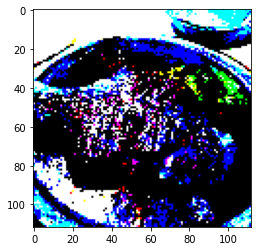

In [ ]:
from matplotlib import pyplot as plt

plt.figure()
plt.imshow(x_train[0])
plt.show()

In [ ]:
x_train.shape, y_train.shape

((174731, 112, 112, 3), (174731,))

In [ ]:
x_val.shape, y_val.shape

((20200, 112, 112, 3), (20200,))

In [ ]:
x_train[0][0]

array([[ -67.843834,  -80.104546,  -93.10116 ],
       [ -67.89029 ,  -80.32686 ,  -93.2322  ],
       [ -68.14977 ,  -80.329445,  -93.51893 ],
       [ -68.03276 ,  -80.55565 ,  -93.53446 ],
       [ -68.350136,  -80.60377 ,  -93.89463 ],
       [ -68.26097 ,  -80.8849  ,  -93.93732 ],
       [ -68.58096 ,  -80.918884,  -94.29401 ],
       [ -68.53122 ,  -81.227234,  -94.37046 ],
       [ -68.894196,  -81.33967 ,  -94.77192 ],
       [ -68.72542 ,  -81.55965 ,  -94.75967 ],
       [ -69.04962 ,  -81.61206 ,  -95.15184 ],
       [ -68.943665,  -81.91421 ,  -95.23641 ],
       [ -69.23284 ,  -81.94902 ,  -95.62437 ],
       [ -69.1215  ,  -82.20504 ,  -95.74431 ],
       [ -71.288445,  -84.26317 ,  -98.265   ],
       [ -71.123474,  -84.62822 ,  -98.377495],
       [ -73.59432 ,  -84.64831 ,  -98.894196],
       [ -73.38529 ,  -84.96265 ,  -98.900444],
       [ -73.73202 ,  -85.03892 ,  -99.346016],
       [ -73.630295,  -85.39366 ,  -99.47035 ],
       [ -73.85829 ,  -85.36426 ,  -99.8

In [ ]:
x_train, x_val = x_train / 255.0, x_val / 255.0

In [ ]:
x_test = x_test / 255.0

### 2. 모델 구축
- Filtering 층과 Classification 층으로 구분
- Filtering 층 : Dense 대신 Conv2D, MaxPooling2D 사용
    - Conv2D : 
        - filter개수
        - filter_size
        - stride : default = 1
    - MaxPooling2D : 
        - filter_size
        - stride : default = filter_size

- model.summary()
    - 모델 구조, weight 개수 세기 정답지
    - Output Shape : 피처맵 
    - param # : weight 개수

In [ ]:
#모델 구축
model = models.Sequential()
## filtering layer
model.add(layers.Conv2D(64, (3, 3), activation='relu',input_shape=(112, 112, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((3, 3)))
model.add(layers.Conv2D(256, (3, 3), activation='relu'))

## classification layer
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

#모델 컴파일
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
model.fit(x_train, y_train, epochs=10,verbose=1)

InternalError: ignored

In [ ]:
#모델 학습
results = model.fit(x_train, y_train, epochs=10, verbose=1, validation_data=(x_val, y_val))
# # list all data in history
print(results.history.keys())
# summarize history for accuracy
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(results.history['loss'])
plt.plot(results.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

InternalError: ignored

In [ ]:
#모델 검증
test_loss, test_acc = model.evaluate(x_test,  y_test, verbose=1)
print(test_acc)

38/38 [==============================] - 1s 15ms/step - loss: 2.1108 - accuracy: 0.7083
0.7083333134651184


In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 110, 110, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 55, 55, 32)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 53, 53, 64)        18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 26, 26, 64)       0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 flatten_3 (Flatten)         (None, 73728)            